# Exploratory DataAnalysis -Load, wind and solar, prices in 12hr resolution

This data package contains different kinds of timeseries data relevant for
power system modelling, namely electricity prices, electricity consumption
(load) as well as wind and solar power generation and capacities. The data
is aggregated either by country, control area or bidding zone.

Data Set Link : https://data.open-power-system-data.org/time_series/

### Original Dataset

In [54]:
import pandas as pd
import plotly.express as px

# Load the data
d = pd.read_csv('time_series_15min_singleindex.csv', parse_dates=['utc_timestamp'])
d

,utc_timestamp,cet_cest_timestamp,AT_load_actual_entsoe_transparency,AT_load_forecast_entsoe_transparency,AT_price_day_ahead,AT_solar_generation_actual,AT_wind_onshore_generation_actual,BE_load_actual_entsoe_transparency,BE_load_forecast_entsoe_transparency,DE_load_actual_entsoe_transparency,...,HU_solar_generation_actual,HU_wind_onshore_generation_actual,LU_load_actual_entsoe_transparency,LU_load_forecast_entsoe_transparency,NL_load_actual_entsoe_transparency,NL_load_forecast_entsoe_transparency,NL_solar_generation_actual,NL_wind_generation_actual,NL_wind_offshore_generation_actual,NL_wind_onshore_generation_actual
0,2014-12-31 23:00:00+00:00,2015-01-01T00:00:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2014-12-31 23:15:00+00:00,2015-01-01T00:15:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2014-12-31 23:30:00+00:00,2015-01-01T00:30:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2014-12-31 23:45:00+00:00,2015-01-01T00:45:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2015-01-01 00:00:00+00:00,2015-01-01T01:00:00+0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
201599,2020-09-30 22:45:00+00:00,2020-10-01T00:45:00+0200,5482.4,5284.0,NaN,NaN,1740.0,7916.55,8105.94,46229.48,...,NaN,157.28,384.36,382.0,12324.95,12094.02,NaN,908.51,640.25,268.26
201600,2020-09-30 23:00:00+00:00,2020-10-01T01:00:00+0200,5464.0,5272.0,NaN,NaN,1712.0,7912.79,8025.29,45792.82,...,NaN,153.32,382.41,371.0,12218.53,11950.22,NaN,925.15,669.88,255.27
201601,2020-09-30 23:15:00+00:00,2020-10-01T01:15:00+0200,5390.4,5200.0,NaN,NaN,1672.0,7818.72,7931.56,45471.18,...,NaN,147.56,378.74,368.0,12076.92,11832.26,NaN,975.34,719.18,256.16
201602,2020-09-30 23:30:00+00:00,2020-10-01T01:30:00+0200,5329.2,5140.0,NaN,NaN,1600.0,7780.18,7872.25,45119.89,...,NaN,137.19,375.86,369.0,11929.69,11717.22,NaN,976.64,721.50,255.14


### Modified Data for Modeling

In [56]:
import pandas as pd
import plotly.express as px

# Load the data
df = pd.read_csv('filtered_data.csv', parse_dates=['utc_timestamp'])
df

,utc_timestamp,cet_cest_timestamp,AT_load_actual_entsoe_transparency,AT_load_forecast_entsoe_transparency,AT_price_day_ahead,AT_solar_generation_actual,AT_wind_onshore_generation_actual,BE_load_actual_entsoe_transparency,BE_load_forecast_entsoe_transparency,DE_load_actual_entsoe_transparency,...,HU_load_forecast_entsoe_transparency,HU_wind_onshore_generation_actual,LU_load_actual_entsoe_transparency,LU_load_forecast_entsoe_transparency,NL_load_actual_entsoe_transparency,NL_load_forecast_entsoe_transparency,NL_solar_generation_actual,NL_wind_generation_actual,NL_wind_offshore_generation_actual,NL_wind_onshore_generation_actual
0,2014-12-31 23:00:00+00:00,2015-01-01T00:00:00+0100,6177.6,6184.00,32.74,0.00,512.00,9210.80,9177.35,47907.60,...,4236.00,56.66,456.02,459,11055.00,11544.39,0.0,771.01,275.44,461.745
1,2015-01-01 00:00:00+00:00,2015-01-01T01:00:00+0100,6177.6,6184.00,32.74,0.00,512.00,9210.80,9177.35,47907.60,...,4236.00,56.66,456.02,459,11055.00,11544.39,0.0,771.01,275.44,461.745
2,2015-01-01 11:00:00+00:00,2015-01-01T12:00:00+0100,7218.4,7528.69,62.82,35.89,172.32,9087.09,10027.32,47875.57,...,4087.98,56.66,357.00,328,11937.82,14153.04,309.0,1666.78,166.68,1500.100
3,2015-01-01 23:00:00+00:00,2015-01-02T00:00:00+0100,5650.8,6564.00,48.40,0.00,106.80,9689.14,9729.72,42967.41,...,3685.56,8.33,402.00,364,9253.15,10017.55,0.0,2507.24,250.72,2256.520
4,2015-01-02 00:00:00+00:00,2015-01-02T01:00:00+0100,5240.8,6441.12,36.00,0.00,82.33,9204.77,8993.62,41222.93,...,3523.68,7.63,373.00,346,8517.17,9196.94,0.0,2495.67,249.57,2246.100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6296,2020-09-29 11:00:00+00:00,2020-09-29T13:00:00+0200,7874.8,7740.00,32.74,352.00,1644.00,9998.08,10477.22,67107.66,...,4974.30,116.01,604.95,564,13590.71,12538.07,0.0,154.70,123.16,31.540
6297,2020-09-29 23:00:00+00:00,2020-09-30T01:00:00+0200,5427.2,5272.00,32.74,0.00,1792.00,7958.10,8227.58,45301.88,...,4242.00,101.79,436.06,400,12543.38,12440.30,0.0,235.43,183.74,51.690
6298,2020-09-30 00:00:00+00:00,2020-09-30T02:00:00+0200,5296.0,5168.00,32.74,0.00,1748.00,7560.50,7887.40,44079.89,...,3970.89,93.38,424.59,395,12190.10,12029.41,0.0,308.11,177.74,130.370
6299,2020-09-30 11:00:00+00:00,2020-09-30T13:00:00+0200,7847.6,7820.00,32.74,344.00,2048.00,10160.92,10483.55,65992.63,...,5312.30,238.32,598.87,562,13816.68,12500.52,0.0,478.07,422.42,55.650


### Correlation Matrix

In [58]:
da = df.drop('cet_cest_timestamp',axis=1)
correlation_matrix = da.corr()
correlation_matrix


,utc_timestamp,AT_load_actual_entsoe_transparency,AT_load_forecast_entsoe_transparency,AT_price_day_ahead,AT_solar_generation_actual,AT_wind_onshore_generation_actual,BE_load_actual_entsoe_transparency,BE_load_forecast_entsoe_transparency,DE_load_actual_entsoe_transparency,DE_load_forecast_entsoe_transparency,...,HU_load_forecast_entsoe_transparency,HU_wind_onshore_generation_actual,LU_load_actual_entsoe_transparency,LU_load_forecast_entsoe_transparency,NL_load_actual_entsoe_transparency,NL_load_forecast_entsoe_transparency,NL_solar_generation_actual,NL_wind_generation_actual,NL_wind_offshore_generation_actual,NL_wind_onshore_generation_actual
utc_timestamp,1.000000,-0.011414,-0.107616,0.095160,0.119060,0.140793,-0.203922,-0.177061,-0.019547,-0.004331,...,0.037129,-0.020008,-0.140438,-0.079885,0.167834,-0.225982,-0.110157,-0.031532,0.283036,-0.200963
AT_load_actual_entsoe_transparency,-0.011414,1.000000,0.945367,0.336791,0.497251,0.057467,0.906322,0.917710,0.938158,0.929244,...,0.915437,0.029569,0.684402,0.634133,0.856990,0.664917,0.367960,0.127788,0.137067,0.111765
AT_load_forecast_entsoe_transparency,-0.107616,0.945367,1.000000,0.321678,0.494049,0.046055,0.908836,0.920828,0.919656,0.917726,...,0.886247,0.043655,0.676837,0.616785,0.836459,0.690713,0.369113,0.135783,0.118682,0.133563
AT_price_day_ahead,0.095160,0.336791,0.321678,1.000000,0.115290,-0.094881,0.338091,0.317329,0.321890,0.327438,...,0.349808,-0.099835,0.378278,0.247520,0.338733,0.296393,0.178785,-0.244353,-0.100456,-0.271264
AT_solar_generation_actual,0.119060,0.497251,0.494049,0.115290,1.000000,-0.076218,0.416844,0.444995,0.641028,0.658431,...,0.543779,-0.082509,0.297983,0.234313,0.468592,0.274026,0.603754,-0.074420,-0.049258,-0.082155
AT_wind_onshore_generation_actual,0.140793,0.057467,0.046055,-0.094881,-0.076218,1.000000,0.045269,0.046845,0.014552,0.008577,...,0.014789,0.794880,-0.031174,0.023539,0.043703,-0.028898,-0.083080,0.105347,0.157175,0.069755
BE_load_actual_entsoe_transparency,-0.203922,0.906322,0.908836,0.338091,0.416844,0.045269,1.000000,0.975381,0.885720,0.876308,...,0.869958,0.059332,0.726450,0.646531,0.783589,0.630688,0.343561,0.090908,0.047906,0.120946
BE_load_forecast_entsoe_transparency,-0.177061,0.917710,0.920828,0.317329,0.444995,0.046845,0.975381,1.000000,0.896366,0.891513,...,0.881623,0.056579,0.699677,0.638671,0.786918,0.638508,0.364446,0.133162,0.087605,0.157802
DE_load_actual_entsoe_transparency,-0.019547,0.938158,0.919656,0.321890,0.641028,0.014552,0.885720,0.896366,1.000000,0.983010,...,0.934232,-0.007699,0.694559,0.608608,0.863737,0.667591,0.456017,0.092555,0.085860,0.086953
DE_load_forecast_entsoe_transparency,-0.004331,0.929244,0.917726,0.327438,0.658431,0.008577,0.876308,0.891513,0.983010,1.000000,...,0.930993,-0.007696,0.668456,0.594992,0.850912,0.664628,0.465381,0.092264,0.086300,0.086103



### Load Data 
- Represents the demand for electricity at any given time


### Solar Generation Actual
 - Represents the amount of electricity generated by solar panels at any given time
### Wind Generation Actual
      
   - Onshore Wind Generation - wind energy generated by turbines located on land.

 - Offshore Wind Generation - wind energy generated by turbines located in bodies of water


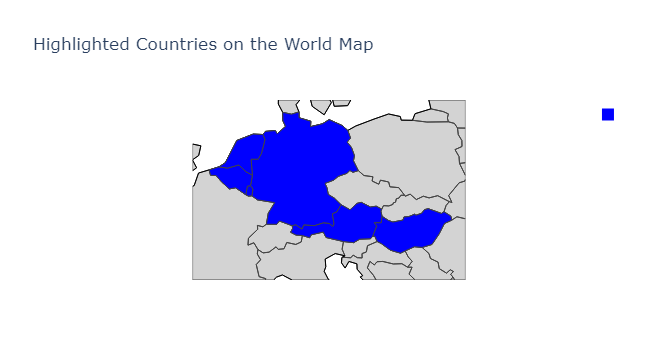

In [186]:
import plotly.express as px

# Create a world map with all countries highlighted
fig = px.choropleth(locations=['Germany', 'Luxemburg', 'Austria', 'Belgium', 'Netherlands','Hungary'],
                     locationmode='country names',  # or 'ISO-3' for ISO codes
                     color_discrete_sequence=['blue'],  # Choose any color for all countries
                     scope='europe',  # Set to 'world' to display the entire map
                     title='Highlighted Countries on the World Map')

# Update layout for better visibility
fig.update_geos(showcoastlines=True, coastlinecolor="Black",
                showland=True, landcolor="lightgray",
                showlakes=True, lakecolor="lightgray",
                projection_type='natural earth')

fig.show()


**Highlighted countries are**

1. *Austria*(AT)
2. *Germany*(DE)
3. *Hungary*(HU)
4. *Luxembourg*(LU)
5. *Belgium*(BE)

### Correlation matrix

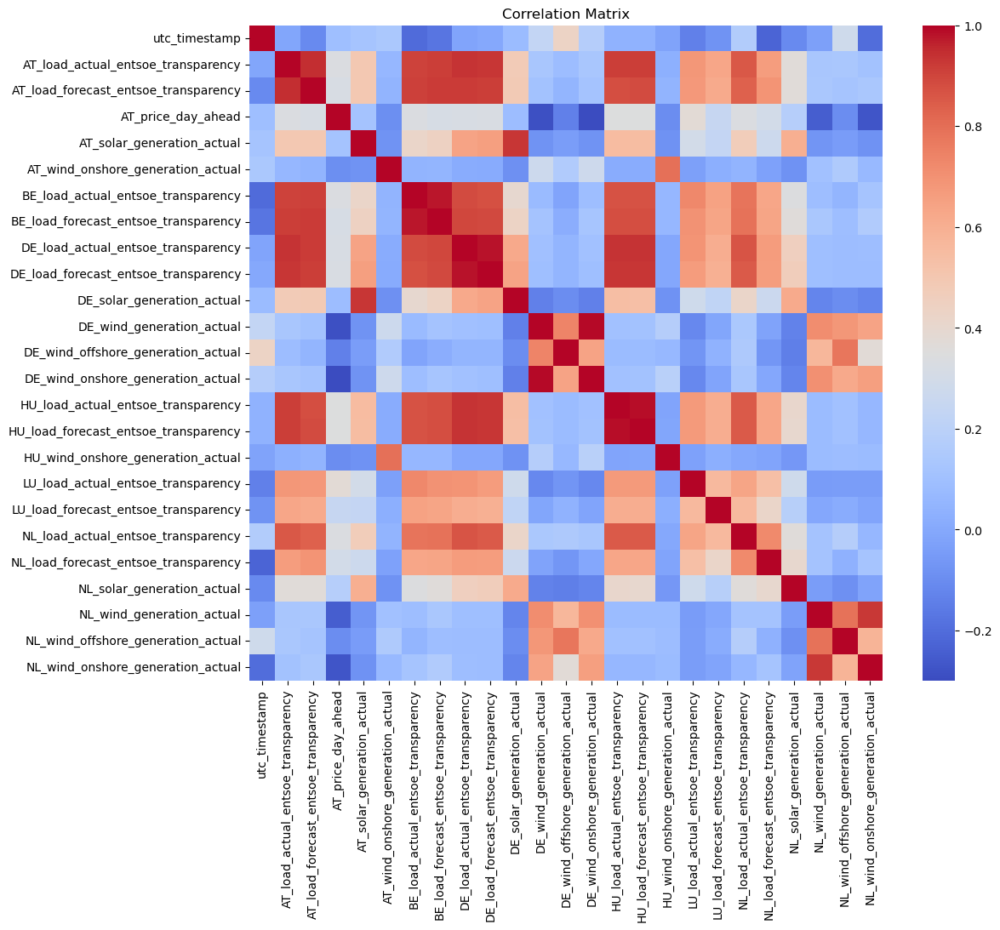

In [60]:
import seaborn as sns
import matplotlib.pyplot as plt
da = df.drop('cet_cest_timestamp',axis=1)
corr = da.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(corr, annot=False, fmt='.2f', cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()


**Key Observations from the Correlation Matrix:**

1. **Strong Negative Correlation between Load and Price:** As the load increases, the price tends to decrease, suggesting demand-response programs or increased renewable energy generation.
2. **Moderate Negative Correlation between Load and Wind Generation:** Higher load is associated with lower wind generation, likely due to wind patterns or grid constraints.
3. **Weak or No Correlation between Load and Solar Generation:** Solar generation is less correlated with load, potentially due to its intermittent nature or energy storage systems.


### Countries being considered for Analysis


### Time Series plot of the Energy load required for each county

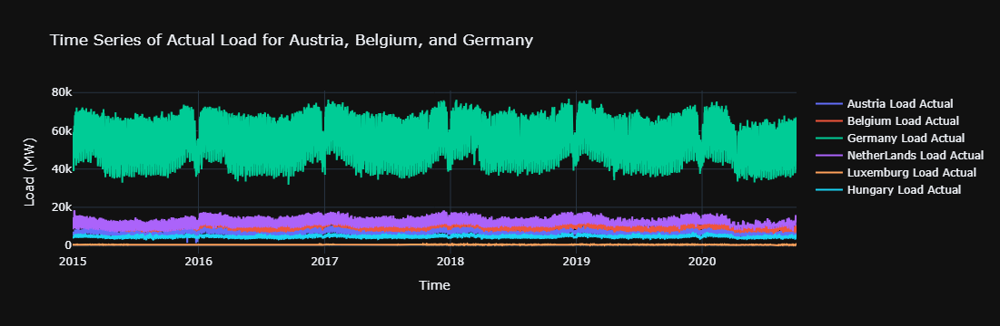

In [66]:
import plotly.graph_objects as go

# Step 6: Create a time series plot for selected columns related to load data
fig = go.Figure()

# Plot the actual load for Austria, Belgium, and Germany
fig.add_trace(go.Scatter(x=df['utc_timestamp'], y=df['AT_load_actual_entsoe_transparency'],
                         mode='lines', name='Austria Load Actual'))
fig.add_trace(go.Scatter(x=df['utc_timestamp'], y=df['BE_load_actual_entsoe_transparency'],
                         mode='lines', name='Belgium Load Actual'))
fig.add_trace(go.Scatter(x=df['utc_timestamp'], y=df['DE_load_actual_entsoe_transparency'],
                         mode='lines', name='Germany Load Actual'))
fig.add_trace(go.Scatter(x=df['utc_timestamp'], y=df['NL_load_actual_entsoe_transparency'],
                         mode='lines', name='NetherLands Load Actual'))
fig.add_trace(go.Scatter(x=df['utc_timestamp'], y=df['LU_load_actual_entsoe_transparency'],
                         mode='lines', name='Luxemburg Load Actual'))
fig.add_trace(go.Scatter(x=df['utc_timestamp'], y=df['HU_load_actual_entsoe_transparency'],
                         mode='lines', name='Hungary Load Actual'))

# Step 7: Update layout for better visualization
fig.update_layout(
    title='Time Series of Actual Load for Austria, Belgium, and Germany',
    xaxis_title='Time',
    yaxis_title='Load (MW)',
    hovermode='x unified',
    template='plotly_dark'
)

# Step 8: Show the interactive plot
fig.show()

**Key Observations from the Time Series:**

1. **Seasonal Patterns:** Load is higher in winter and lower in summer, particularly for Austria, Germany, and the Netherlands.
2. **Peak Load:** Occasional periods of peak load occur, especially in winter months.
3. **Correlation:** Load patterns for Austria, Belgium, and Germany are somewhat correlated, suggesting shared influencing factors.


### Box Plot of Actual Load Across Different Regions

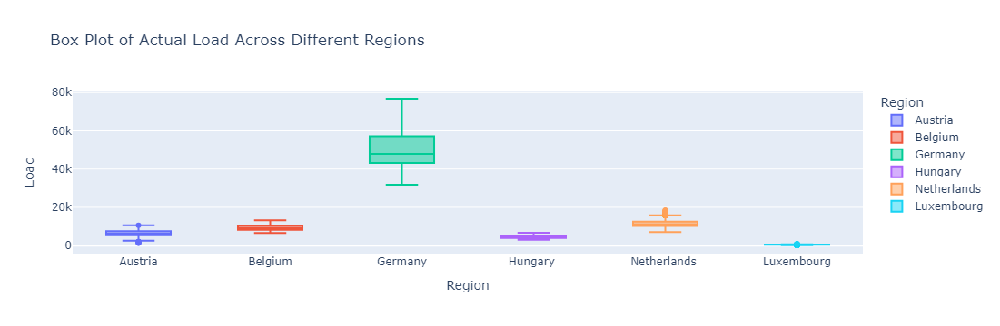

In [69]:
import plotly.express as px
data = df
# Box Plot for Load Actual in Different Regions
box_data = pd.DataFrame({
    'Region': ['Austria'] * len(data['AT_load_actual_entsoe_transparency']) +
              ['Belgium'] * len(data['BE_load_actual_entsoe_transparency']) +
              ['Germany'] * len(data['DE_load_actual_entsoe_transparency']) +
              ['Hungary '] * len(data['HU_load_actual_entsoe_transparency']) +
              ['Netherlands '] * len(data['NL_load_actual_entsoe_transparency']) +
              ['Luxembourg'] * len(data['LU_load_actual_entsoe_transparency']),
    'Load': list(data['AT_load_actual_entsoe_transparency']) +
            list(data['BE_load_actual_entsoe_transparency']) +
            list(data['DE_load_actual_entsoe_transparency']) +
            list(data['HU_load_actual_entsoe_transparency']) +
            list(data['NL_load_actual_entsoe_transparency']) +
            list(data['LU_load_actual_entsoe_transparency'])
})

fig = px.box(box_data, x='Region', y='Load', color='Region', title='Box Plot of Actual Load Across Different Regions')
fig.show()


**Inferences from the Box Plot of Actual Load**

1. **Median Load:** Germany has the highest median load, followed by Austria and Belgium. Luxembourg has the lowest median load.
2. **Variability:** The interquartile ranges (IQRs) vary among regions. Germany has the largest IQR, indicating a wider spread of load values. Luxembourg has the smallest IQR, suggesting a more consistent load distribution.
3. **Regional Differences:** The box plots show distinct differences in load distribution across regions, potentially influenced by factors like economic activity, energy mix, population density, and climate.
4. **Outliers:** Some regions, such as Germany and the Netherlands, exhibit outliers, indicating extreme load values that may require further investigation.
5. **Overall Distribution:** The box plots provide a visual representation of the overall load distribution for each region, allowing for comparisons and identification of trends.


### Time Series of Solar and Wind Generation of Austria, Netherlands, Germany

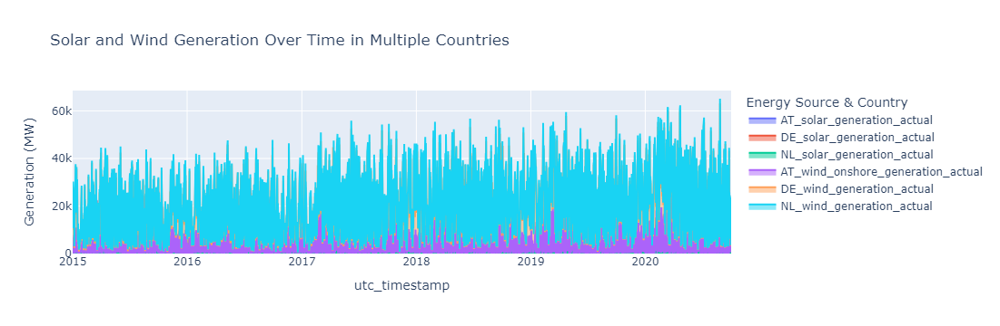

In [75]:
columns = ['AT_solar_generation_actual', 'DE_solar_generation_actual',
           'NL_solar_generation_actual', 'AT_wind_onshore_generation_actual',
           'DE_wind_generation_actual', 'NL_wind_generation_actual']

# Plot stacked area chart for solar and wind generation
fig = px.area(df, x='utc_timestamp', y=columns,
              labels={'value': 'Generation (MW)', 'variable': 'Energy Source & Country'},
              title='Solar and Wind Generation Over Time in Multiple Countries')

fig.show()


**Key Observations from the Time Series of Solar and Wind Generation:**

1. **Growth in Renewable Energy:** Both solar and wind generation have increased significantly over time, indicating a growing reliance on renewable energy sources.
2. **Seasonal Patterns:** Solar generation is higher in summer, while wind generation varies depending on regional patterns.


### Parallel Coordinates Plot for Multiple Variables in Germany

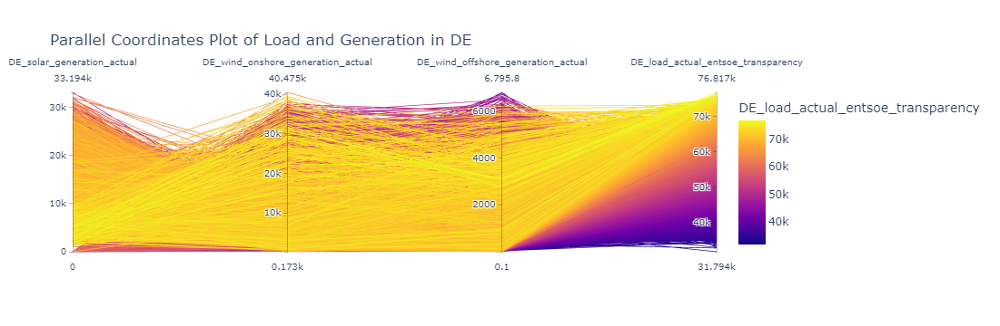

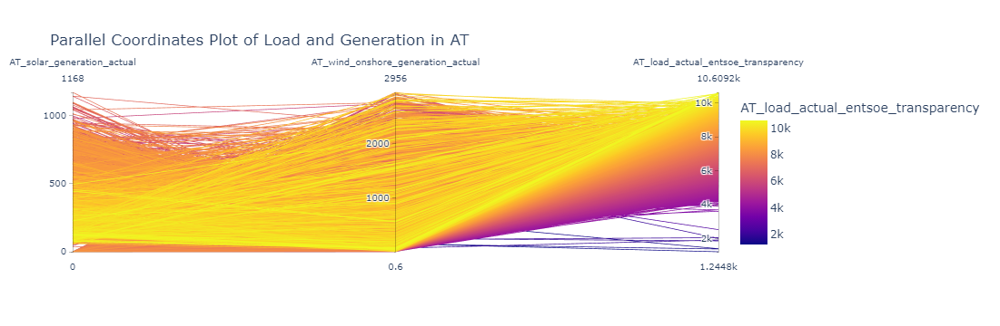

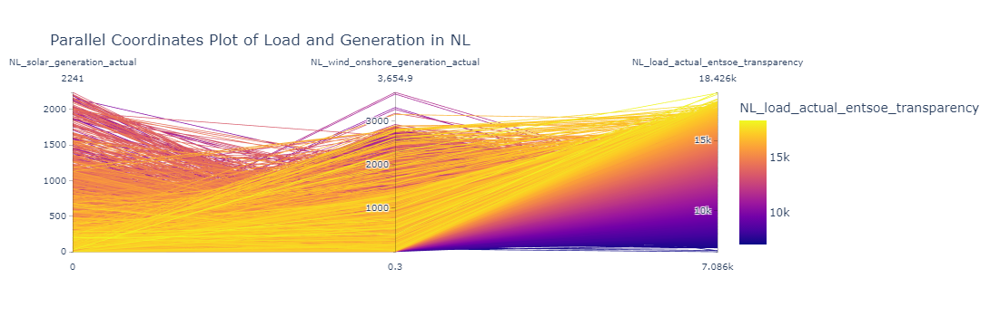

In [248]:
import plotly.express as px

# Parallel Coordinates Plot for Multiple Variables in DE
fig = px.parallel_coordinates(data, color='DE_load_actual_entsoe_transparency', dimensions=['DE_solar_generation_actual', 
              'DE_wind_onshore_generation_actual', 
              'DE_wind_offshore_generation_actual', 
              'DE_load_actual_entsoe_transparency'],
              title='Parallel Coordinates Plot of Load and Generation in DE')
fig.show()
fig = px.parallel_coordinates(data, color='AT_load_actual_entsoe_transparency', dimensions=['AT_solar_generation_actual', 
              'AT_wind_onshore_generation_actual',
              'AT_load_actual_entsoe_transparency'],
              title='Parallel Coordinates Plot of Load and Generation in AT')
fig.show()
fig = px.parallel_coordinates(data, color='NL_load_actual_entsoe_transparency', dimensions=['NL_solar_generation_actual', 
              'NL_wind_onshore_generation_actual',
              'NL_load_actual_entsoe_transparency'],
              title='Parallel Coordinates Plot of Load and Generation in NL')
fig.show()

**Inference** : 
1. **Comparative Load Trends**: The plot helps compare how energy loads differ across Austria, Germany, Hungary, and the Netherlands over time.
  
2. **Correlations Between Countries**: It reveals potential correlations in load patterns between countries, indicating similar behavior in energy demand.

3. **Outliers and Anomalies**: The plot can highlight any sudden spikes or dips, signaling unusual events or outliers in energy demand.

4. **Variability Within Countries**: It shows how much energy demand fluctuates within each country, with wider spreads indicating higher variability.

5. **Load Distribution**: The plot provides insight into the typical load ranges for each country, showing whether the demand is concentrated or widely spread across values.

### Scatter plot with Marginal Histograms for Actual Vs Forecast load of Austria

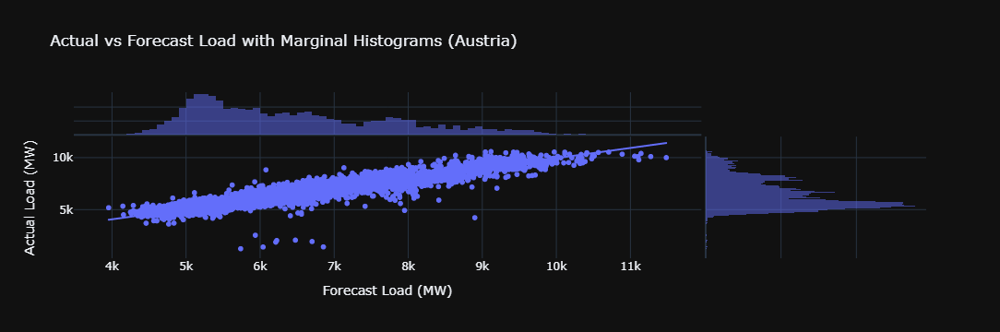

In [256]:
import plotly.express as px

# Sample data preparation (actual vs. forecast for Austria)
df_sample = df[['AT_load_actual_entsoe_transparency', 'AT_load_forecast_entsoe_transparency']].dropna()

# Create scatter plot with marginal histograms
fig = px.scatter(
    df_sample,
    x='AT_load_forecast_entsoe_transparency',
    y='AT_load_actual_entsoe_transparency',
    marginal_x='histogram',
    marginal_y='histogram',
    trendline='ols',  # Optional: Adds a trendline to show correlation
    title='Actual vs Forecast Load with Marginal Histograms (Austria)',
    labels={
        'AT_load_forecast_entsoe_transparency': 'Forecast Load (MW)',
        'AT_load_actual_entsoe_transparency': 'Actual Load (MW)'
    }
)

# Customize layout
fig.update_layout(
    hovermode='closest',
    template='plotly_dark'
)

# Show the figure
fig.show()


**Key Observations from the Scatter Plot with Marginal Histograms:**

1. **Positive Correlation:** There is a strong positive correlation between actual and forecast load, indicating accurate forecasting.
2. **Error Analysis:** The scatter around the line and marginal histograms provide insights into the nature and magnitude of forecast errors.


### Scatter plot with Marginal Histograms for Actual Vs Forecast load of Germany

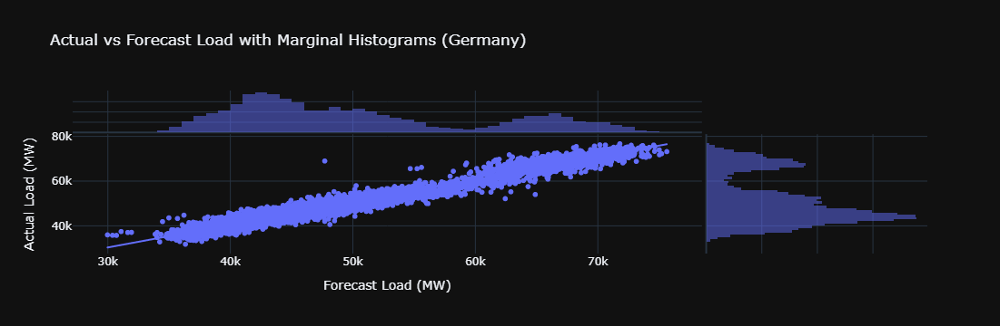

In [81]:
import plotly.express as px

# Sample data preparation (actual vs. forecast for Austria)
df_sample = df[['DE_load_actual_entsoe_transparency', 'DE_load_forecast_entsoe_transparency']].dropna()

# Create scatter plot with marginal histograms
fig = px.scatter(
    df_sample,
    x='DE_load_forecast_entsoe_transparency',
    y='DE_load_actual_entsoe_transparency',
    marginal_x='histogram',
    marginal_y='histogram',
    trendline='ols',  # Optional: Adds a trendline to show correlation
    title='Actual vs Forecast Load with Marginal Histograms (Germany)',
    labels={
        'DE_load_forecast_entsoe_transparency': 'Forecast Load (MW)',
        'DE_load_actual_entsoe_transparency': 'Actual Load (MW)'
    }
)

# Customize layout
fig.update_layout(
    hovermode='closest',
    template='plotly_dark'
)

# Show the figure
fig.show()


**Key Observations from the Scatter Plot with Marginal Histograms:**

1. **Positive Correlation:** There is a strong positive correlation between actual and forecast load, indicating accurate forecasting.
2. **Error Analysis:** The scatter around the line and marginal histograms provide insights into the nature and magnitude of forecast errors.

  Same as like Austria

### Scatter plot with Marginal Histograms for Actual Vs Forecast load of Netherlands

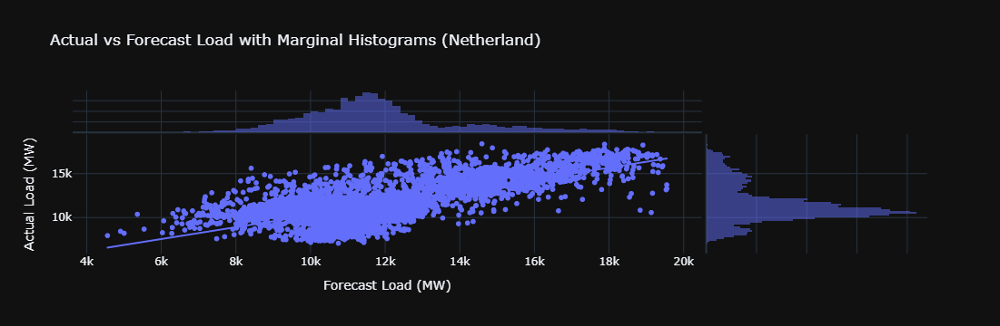

In [84]:
import plotly.express as px

# Sample data preparation (actual vs. forecast for Austria)
df_sample = df[['NL_load_actual_entsoe_transparency', 'NL_load_forecast_entsoe_transparency']].dropna()

# Create scatter plot with marginal histograms
fig = px.scatter(
    df_sample,
    x='NL_load_forecast_entsoe_transparency',
    y='NL_load_actual_entsoe_transparency',
    marginal_x='histogram',
    marginal_y='histogram',
    trendline='ols',  # Optional: Adds a trendline to show correlation
    title='Actual vs Forecast Load with Marginal Histograms (Netherland)',
    labels={
        'NL_load_forecast_entsoe_transparency': 'Forecast Load (MW)',
        'NL_load_actual_entsoe_transparency': 'Actual Load (MW)'
    }
)

# Customize layout
fig.update_layout(
    hovermode='closest',
    template='plotly_dark'
)

# Show the figure
fig.show()


**Key Observations from the Scatter Plot with Marginal Histograms (Netherlands):**

1. **Positive Correlation:** There is a strong positive correlation between actual and forecast load, indicating accurate forecasting.
2. **Error Analysis:** The scatter around the line and marginal histograms provide insights into the nature and magnitude of forecast errors.


### Scatter plot with Marginal Histograms for Actual Vs Forecast load of Luxembourg

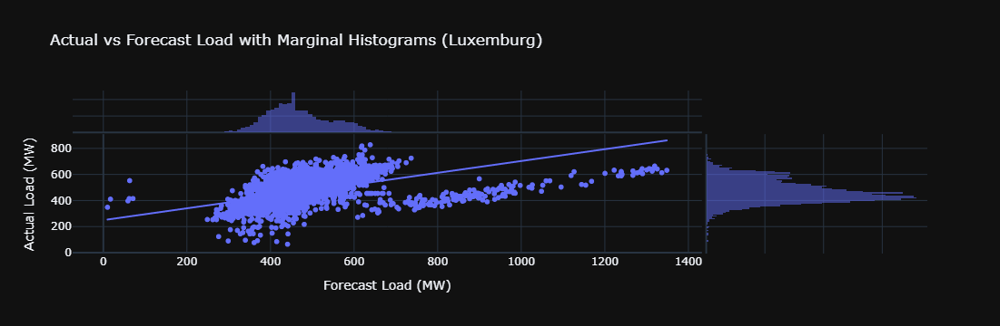

In [87]:
import plotly.express as px

# Sample data preparation (actual vs. forecast for Austria)
df_sample = df[['LU_load_actual_entsoe_transparency', 'LU_load_forecast_entsoe_transparency']].dropna()

# Create scatter plot with marginal histograms
fig = px.scatter(
    df_sample,
    x='LU_load_forecast_entsoe_transparency',
    y='LU_load_actual_entsoe_transparency',
    marginal_x='histogram',
    marginal_y='histogram',
    trendline='ols',  # Optional: Adds a trendline to show correlation
    title='Actual vs Forecast Load with Marginal Histograms (Luxemburg)',
    labels={
        'LU_load_forecast_entsoe_transparency': 'Forecast Load (MW)',
        'LU_load_actual_entsoe_transparency': 'Actual Load (MW)'
    }
)

# Customize layout
fig.update_layout(
    hovermode='closest',
    template='plotly_dark'
)

# Show the figure
fig.show()


**Key Observations from the Scatter Plot with Marginal Histograms (Luxembourg):**

1. **Positive Correlation:** There is a strong positive correlation between actual and forecast load, indicating accurate forecasting.
2. **Error Analysis:** The scatter around the line and marginal histograms provide insights into the nature and magnitude of forecast errors.


### Scatter plot with Marginal Histograms for Actual Vs Forecast load of Hungary

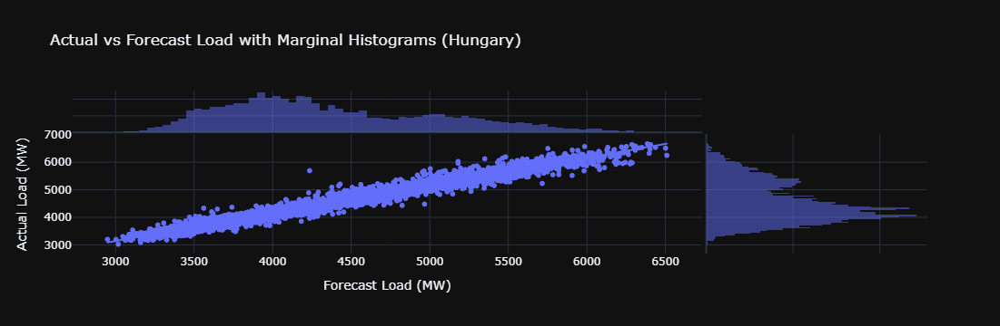

In [90]:
import plotly.express as px

# Sample data preparation (actual vs. forecast for Austria)
df_sample = df[['HU_load_actual_entsoe_transparency', 'HU_load_forecast_entsoe_transparency']].dropna()

# Create scatter plot with marginal histograms
fig = px.scatter(
    df_sample,
    x='HU_load_forecast_entsoe_transparency',
    y='HU_load_actual_entsoe_transparency',
    marginal_x='histogram',
    marginal_y='histogram',
    trendline='ols',  # Optional: Adds a trendline to show correlation
    title='Actual vs Forecast Load with Marginal Histograms (Hungary)',
    labels={
        'HU_load_forecast_entsoe_transparency': 'Forecast Load (MW)',
        'HU_load_actual_entsoe_transparency': 'Actual Load (MW)'
    }
)

# Customize layout
fig.update_layout(
    hovermode='closest',
    template='plotly_dark'
)

# Show the figure
fig.show()


**Key inferences:**

1. There is a strong positive correlation between forecasted and actual load, as indicated by the linear trend.
2. The marginal histograms show a concentration of both actual and forecast loads in the mid-range, indicating common load values.
3. There are some deviations from the line, suggesting occasional forecast errors, but overall, the predictions closely match the actual values.

### Bar chart showing average load by month of Netherlands

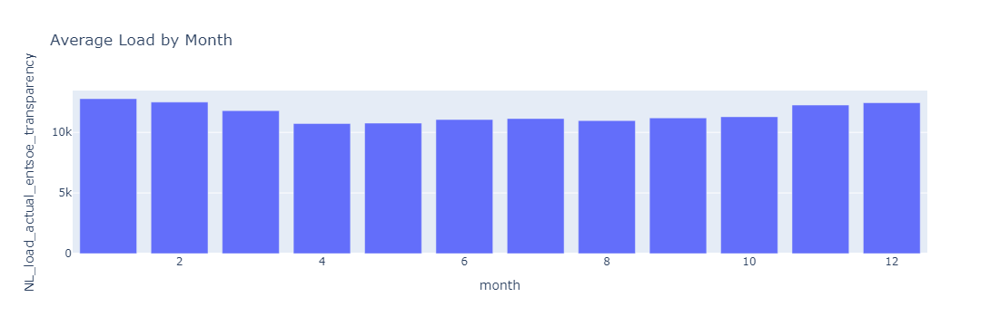

In [93]:
df['month'] = df['utc_timestamp'].dt.month
avg_load_by_month = df.groupby('month')['NL_load_actual_entsoe_transparency'].mean().reset_index()

fig = px.bar(avg_load_by_month, x='month', y='NL_load_actual_entsoe_transparency', title='Average Load by Month')
fig.show()


The chart shows the average load by month. Here are some inferences that can be drawn from the chart:

* The average load is highest in January and December.
* The average load is lowest in April.
* The average load is relatively stable throughout the year, with some seasonal variation.
* The average load is generally higher in the winter months than in the summer months.
* The average load is slightly higher in the first half of the year than in the second half of the year.



### Line Graph showing Average Loads hourly (Austria)

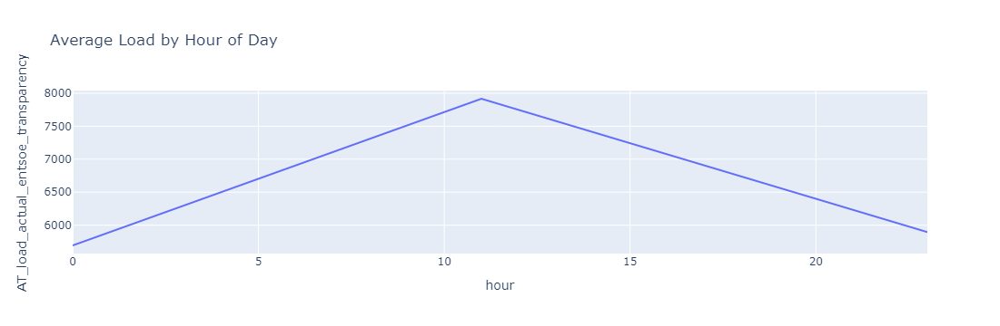

In [96]:
df['hour'] = df['utc_timestamp'].dt.hour
avg_load_by_hour = df.groupby('hour')['AT_load_actual_entsoe_transparency'].mean().reset_index()

fig = px.line(avg_load_by_hour, x='hour', y='AT_load_actual_entsoe_transparency', title='Average Load by Hour of Day')
fig.show()


**Key inferences:**
1. The load steadily increases from early morning (around 0:00) and peaks at midday (around 12:00), indicating higher energy demand during midday hours.
2. After reaching the peak, the load begins to decline consistently towards the evening and late night.
3. This pattern suggests typical energy usage, with demand rising in the morning and dropping after work hours.

### Line Charts depicting Actual load of each country for 5 years

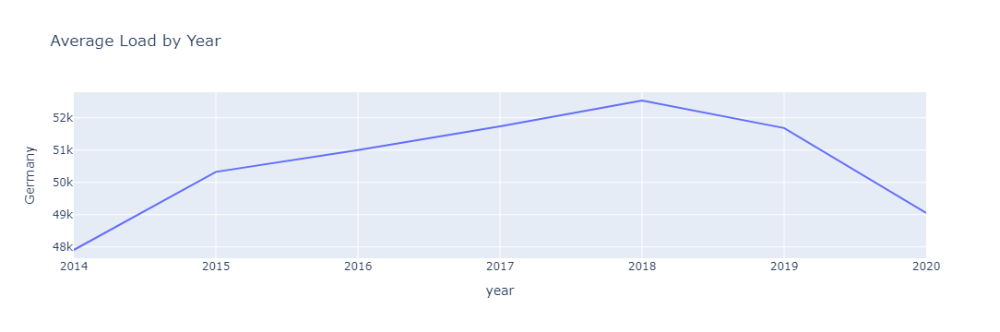

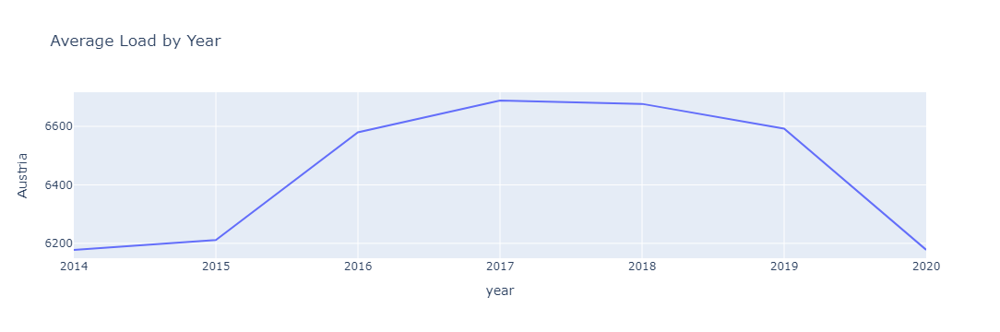

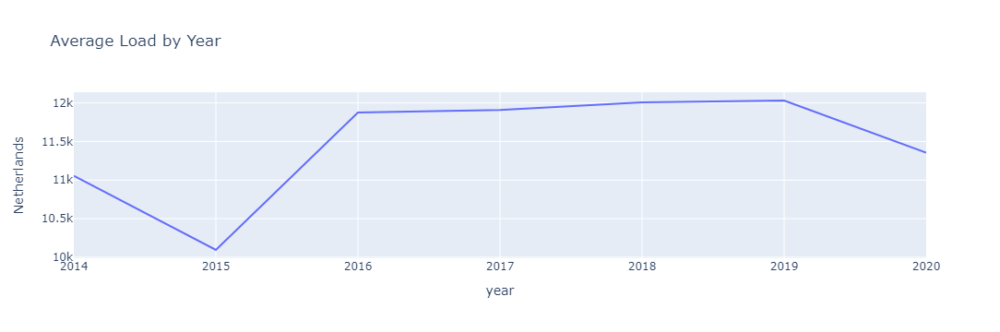

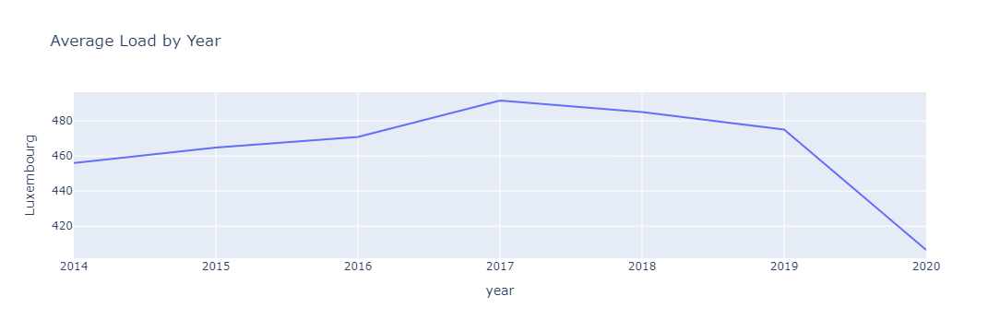

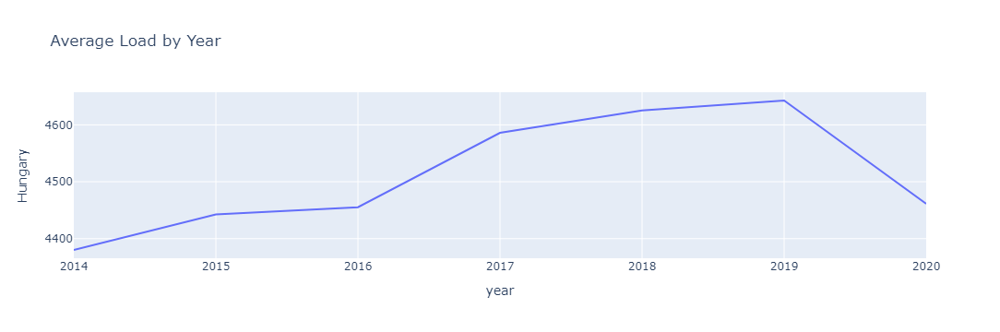

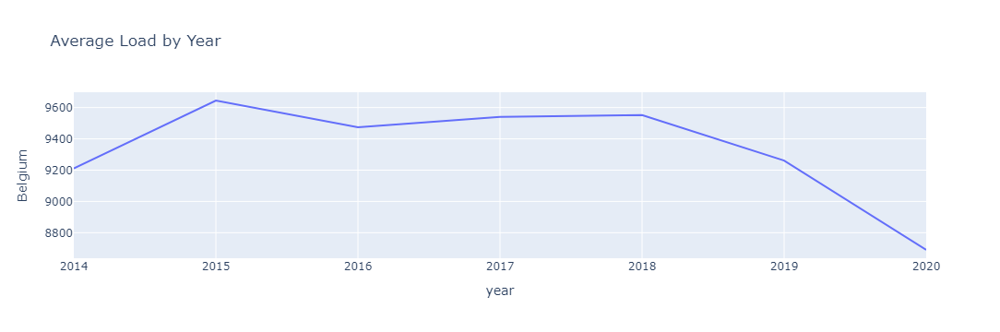

In [99]:
df['year'] = df['utc_timestamp'].dt.year
avg_load_by_year = df.groupby('year')['DE_load_actual_entsoe_transparency'].mean().reset_index()

fig = px.line(avg_load_by_year, x='year', y='DE_load_actual_entsoe_transparency', title='Average Load by Year',labels={'DE_load_actual_entsoe_transparency': 'Germany '})

avg_load_by_year = df.groupby('year')['AT_load_actual_entsoe_transparency'].mean().reset_index()

fig1 = px.line(avg_load_by_year, x='year', y='AT_load_actual_entsoe_transparency', title='Average Load by Year',labels={'AT_load_actual_entsoe_transparency': 'Austria '})

avg_load_by_year = df.groupby('year')['NL_load_actual_entsoe_transparency'].mean().reset_index()

fig2=px.line(avg_load_by_year, x='year', y='NL_load_actual_entsoe_transparency', title='Average Load by Year',labels={'NL_load_actual_entsoe_transparency': 'Netherlands '})

avg_load_by_year = df.groupby('year')['LU_load_actual_entsoe_transparency'].mean().reset_index()

fig3= px.line(avg_load_by_year, x='year', y='LU_load_actual_entsoe_transparency', title='Average Load by Year',labels={'LU_load_actual_entsoe_transparency': 'Luxembourg '})

avg_load_by_year = df.groupby('year')['HU_load_actual_entsoe_transparency'].mean().reset_index()

fig4 = px.line(avg_load_by_year, x='year', y='HU_load_actual_entsoe_transparency', title='Average Load by Year',labels={'HU_load_actual_entsoe_transparency': 'Hungary '})

avg_load_by_year = df.groupby('year')['BE_load_actual_entsoe_transparency'].mean().reset_index()

fig5 = px.line(avg_load_by_year, x='year', y='BE_load_actual_entsoe_transparency', title='Average Load by Year',labels={'BE_load_actual_entsoe_transparency': 'Belgium '})
fig.show()
fig1.show()
fig2.show()
fig3.show()
fig4.show()
fig5.show()

**Inferences from the combined charts:**

* All charts show initial growth followed by decline or plateau.
* Shapes vary, suggesting different underlying processes.
* Chart 1 might represent growth and decay.
* Chart 2 could indicate external factors influencing the process.
* Chart 3 might show accumulation or growth followed by stabilization.
* More context is needed for specific interpretations.


### Line chart Representing cumulative load over time

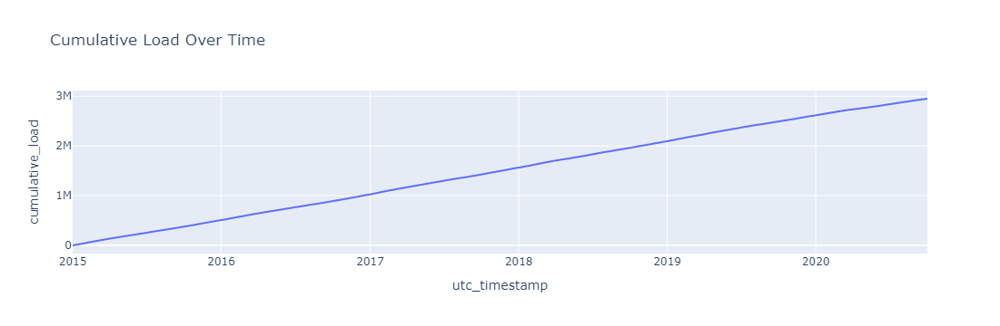

In [102]:
df['cumulative_load'] = df['LU_load_actual_entsoe_transparency'].cumsum()
fig = px.line(df, x='utc_timestamp', y='cumulative_load', title='Cumulative Load Over Time')
fig.show()


**Key inferences:**
1. The cumulative load has been steadily increasing over the years, with no significant fluctuations.
2. The rate of increase might be accelerating towards the end of the period.


### Load Duration Curve of each country over time

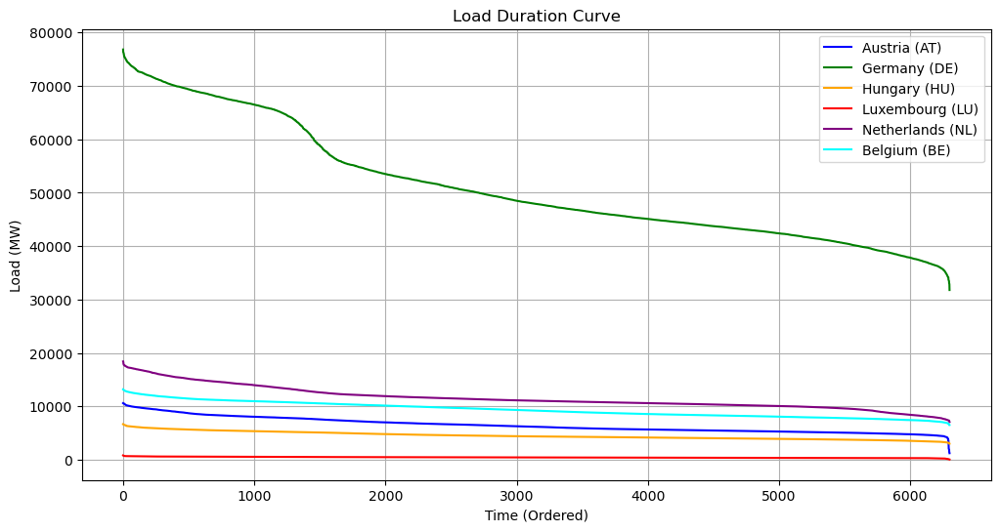

In [105]:
import matplotlib.pyplot as plt

# Sort and plot load duration curves for each country
plt.figure(figsize=(12, 6))  # Set figure size for better visibility

# Austria
load_sorted = df['AT_load_actual_entsoe_transparency'].sort_values(ascending=False)
plt.plot(load_sorted.values, label='Austria (AT)', color='blue')

# Germany
load_sorted = df['DE_load_actual_entsoe_transparency'].sort_values(ascending=False)
plt.plot(load_sorted.values, label='Germany (DE)', color='green')

# Hungary
load_sorted = df['HU_load_actual_entsoe_transparency'].sort_values(ascending=False)
plt.plot(load_sorted.values, label='Hungary (HU)', color='orange')

# Luxembourg
load_sorted = df['LU_load_actual_entsoe_transparency'].sort_values(ascending=False)
plt.plot(load_sorted.values, label='Luxembourg (LU)', color='red')

# Netherlands
load_sorted = df['NL_load_actual_entsoe_transparency'].sort_values(ascending=False)
plt.plot(load_sorted.values, label='Netherlands (NL)', color='purple')

# Belgium
load_sorted = df['BE_load_actual_entsoe_transparency'].sort_values(ascending=False)
plt.plot(load_sorted.values, label='Belgium (BE)', color='cyan')

# Add title and labels
plt.title('Load Duration Curve')
plt.xlabel('Time (Ordered)')
plt.ylabel('Load (MW)')

# Add legend
plt.legend()

# Show plot
plt.grid()
plt.show()



### Inference from the Load Duration Curve:

A *Load Duration Curve (LDC)* shows the variation in load (or demand) over time, ordered from highest to lowest. By plotting these curves for different countries, you can infer several key points:

1. *Maximum Load*: The leftmost point in each curve represents the maximum load (peak demand) for that country. Comparing the curves shows which country has the highest and lowest peak demands.

2. *Demand Consistency*:
   - The steepness of the curve indicates the variability of the load.
   - A steeper curve suggests more variation (i.e., sharp differences between peak and off-peak demand).
   - A flatter curve implies more consistent demand over time.

### Use of Sort Function:

The sort_values(ascending=False) function is used to reorder the original load values from highest to lowest. This sorting is essential for constructing the *Load Duration Curve* because:

- The LDC arranges load values in descending order to show the highest load first and progressively lower values.
  
- Without sorting, the data would reflect the actual time series of loads, which fluctuates up and down, rather than presenting a clear visual of how the load varies between peak and low demand.

By sorting, you can easily visualize the proportion of time that the load stays above certain levels, which is critical for analyzing energy demand and supply characteristics.

### Renewable penetration for each country

In [108]:
country_list = ['AT', 'DE', 'NL']

for country in country_list:
    # Create a renewable penetration column for the current country
    df[f'{country}_renewable_penetration'] = (
        df[f'{country}_solar_generation_actual'] +
        df[f'{country}_wind_onshore_generation_actual']
    ) / df[f'{country}_load_actual_entsoe_transparency'] * 100

    # Calculate the mean renewable penetration
    mean_renewable_penetration = df[f'{country}_renewable_penetration'].mean()
    print(f'Mean Renewable Penetration for {country}: {mean_renewable_penetration:.2f}%')


Mean Renewable Penetration for AT: 13.69%
Mean Renewable Penetration for DE: 27.48%
Mean Renewable Penetration for NL: 7.07%


* **AT:** The mean renewable penetration for AT is 13.69%. This suggests that renewable energy sources like solar and wind contribute to a relatively small portion of the total electricity consumption in AT.
* **DE:** The mean renewable penetration for DE is 27.48%. This indicates that renewable energy plays a more significant role in the electricity mix of DE compared to AT.
* **NL:** The mean renewable penetration for NL is 7.07%. This suggests that renewable energy sources have a limited contribution to the electricity consumption in NL.


### Sankey Diagram for Energy Flow Across Countries

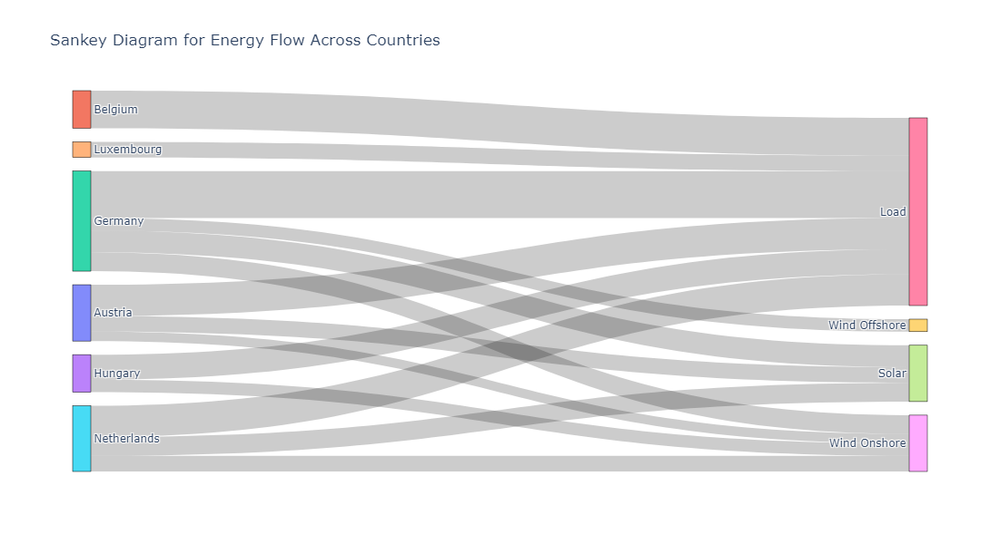

In [117]:
import plotly.graph_objects as go

# Define the node labels
labels = [
    "Austria", "Belgium", "Germany", "Hungary", "Luxembourg", "Netherlands",  # Countries
    "Load", "Solar", "Wind Onshore", "Wind Offshore"  # Energy types
]

# Define the source and target indices for the links
source = [
    0,  # Austria to Load
    0,  # Austria to Solar
    0,  # Austria to Wind
    1,  # Belgium to Load
    2,  # Germany to Load
    2,  # Germany to Solar
    2,  # Germany to Wind Onshore
    2,  # Germany to Wind Offshore
    3,  # Hungary to Load
    3,  # Hungary to Wind Onshore
    4,  # Luxembourg to Load
    5,  # Netherlands to Load
    5,  # Netherlands to Solar
    5   # Netherlands to Wind Onshore
]

target = [
    6,  # Austria to Load
    7,  # Austria to Solar
    8,  # Austria to Wind
    6,  # Belgium to Load
    6,  # Germany to Load
    7,  # Germany to Solar
    8,  # Germany to Wind Onshore
    9,  # Germany to Wind Offshore
    6,  # Hungary to Load
    8,  # Hungary to Wind Onshore
    6,  # Luxembourg to Load
    6,  # Netherlands to Load
    7,  # Netherlands to Solar
    8   # Netherlands to Wind Onshore
]

# Define the values representing the flow
# Example values; adjust these based on your actual data
value = [
    10, 5, 3,  # Austria
    12,         # Belgium
    15, 7, 6, 4,  # Germany
    8, 4,       # Hungary
    5,          # Luxembourg
    10, 6, 5    # Netherlands
]

# Create the Sankey diagram
fig = go.Figure(go.Sankey(
    node=dict(pad=15, thickness=20, line=dict(color="black", width=0.5), label=labels),
    link=dict(source=source, target=target, value=value)
))

# Update layout
fig.update_layout(title='Sankey Diagram for Energy Flow Across Countries', height=600)

# Show the plot
fig.show()



* **Germany** is the largest energy consumer among the countries shown.
* **Belgium** is the largest exporter of energy, with most of it going to Germany.
* **Luxembourg** and **Austria** have relatively small energy flows compared to the other countries.
* **Netherlands** imports a significant amount of energy, primarily from Belgium.
* **Hungary** also imports energy, but to a lesser extent than the Netherlands.
* **Wind Offshore** and **Solar** are the most common renewable energy sources among the countries.
* **Load** represents the total energy consumed by each country


### Price vs. Actual Load in Austria using Scatter plot

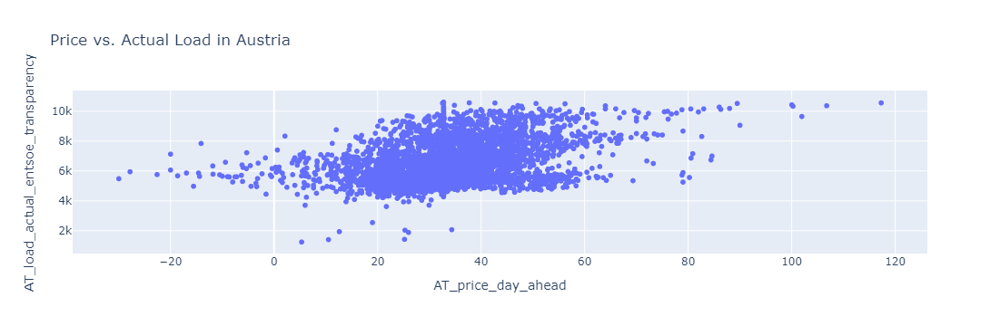

In [120]:
fig = px.scatter(df, x='AT_price_day_ahead', y='AT_load_actual_entsoe_transparency',
                 title='Price vs. Actual Load in Austria', labels={'x': 'Day-Ahead Price (€)', 'y': 'Load (MW)'})
fig.show()


1. There is a weak negative correlation between price and actual load in Austria.
2. The relationship is not perfectly linear, and other factors may influence actual load.


### Price vs. Forecasted Load in Austria using Scatter plot

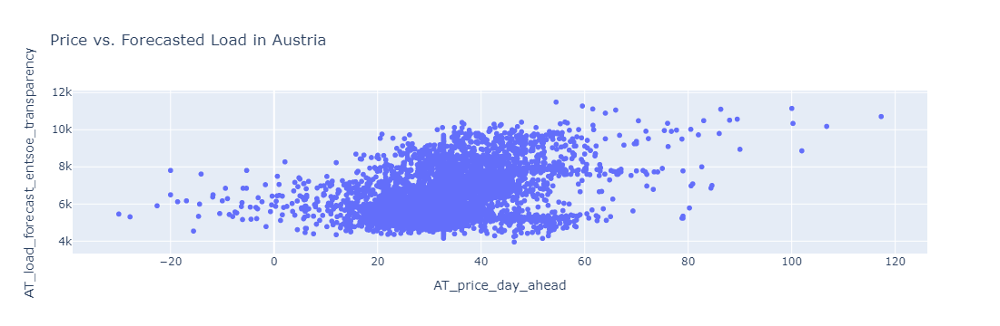

In [123]:
fig = px.scatter(df, x='AT_price_day_ahead', y='AT_load_forecast_entsoe_transparency',
                 title='Price vs. Forecasted Load in Austria', labels={'x': 'Day-Ahead Price (€)', 'y': 'Forecasted Load (MW)'})
fig.show()


1. There is a weak positive correlation between price and forecasted load in Austria.
2. The relationship is not perfectly linear, and other factors may influence forecasted load.


### OLS Regression Analysis (Ordinary Least Squares)

In [126]:
import statsmodels.api as sm

X = df[['AT_price_day_ahead']]
y = df['AT_load_actual_entsoe_transparency']
X = sm.add_constant(X)  # Adds a constant term to the predictor

model = sm.OLS(y, X).fit()
print(model.summary())


                                    OLS Regression Results                                    
Dep. Variable:     AT_load_actual_entsoe_transparency   R-squared:                       0.113
Model:                                            OLS   Adj. R-squared:                  0.113
Method:                                 Least Squares   F-statistic:                     805.9
Date:                                Thu, 03 Oct 2024   Prob (F-statistic):          6.30e-167
Time:                                        11:40:48   Log-Likelihood:                -54159.
No. Observations:                                6301   AIC:                         1.083e+05
Df Residuals:                                    6299   BIC:                         1.083e+05
Df Model:                                           1                                         
Covariance Type:                            nonrobust                                         
                         coef    std err          

The regression analysis shows a significant relationship between "AT_price_day_ahead" and "AT_load_actual_entsoe_transparency." However, the model explains only a small portion of the variation in the dependent variable. The residuals appear to be normally distributed and there is no evidence of autocorrelation.


### Day-Ahead Prices by Day of Week by Box Plot

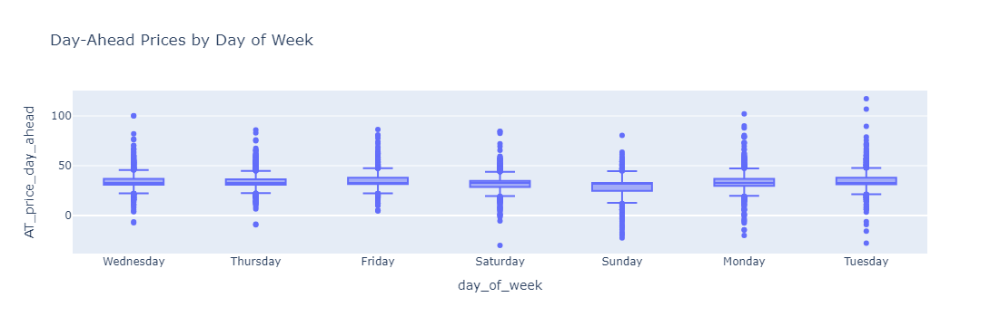

In [129]:
df['day_of_week'] = df['utc_timestamp'].dt.day_name()
fig = px.box(df, x='day_of_week', y='AT_price_day_ahead', title='Day-Ahead Prices by Day of Week')
fig.show()


1. **Wednesday has the highest day-ahead price.**
2. **Saturday has the lowest day-ahead price.**
3. **Distribution of prices varies across days of the week.**


### Line graph Depicting the Rolling Average Day-Ahead Prices

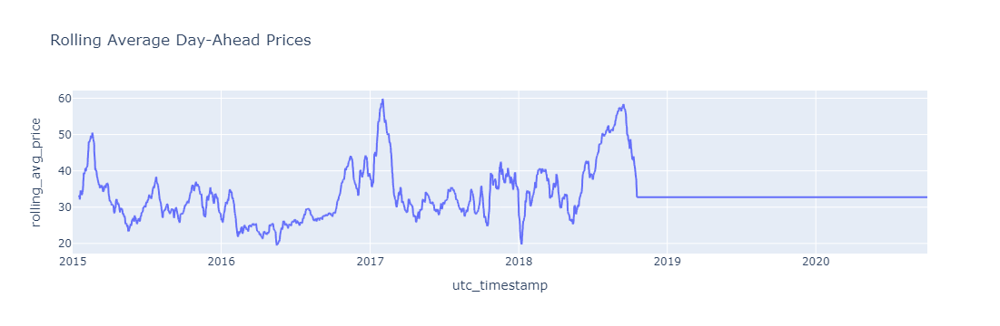

In [132]:
df['rolling_avg_price'] = df['AT_price_day_ahead'].rolling(window=48).mean()
fig = px.line(df, x='utc_timestamp', y='rolling_avg_price', title='Rolling Average Day-Ahead Prices')
fig.show()


Here are some inferences that can be drawn from the line chart:

1. **The rolling average day-ahead price fluctuated significantly from 2015 to 2019.** There were periods of both high and low prices during this time.
2. **The rolling average day-ahead price reached a peak in 2019.** This was followed by a sharp decline.
3. **The rolling average day-ahead price has remained relatively stable since 2019.**


### Average Day-Ahead Price by Hour of Day

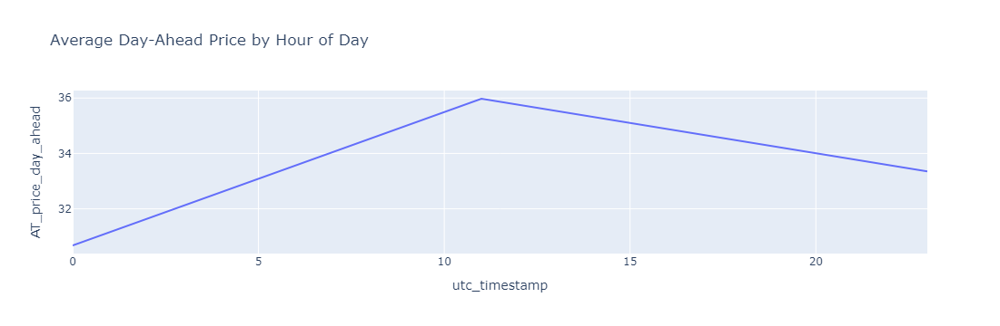

In [135]:
avg_price_by_hour = df.groupby(df['utc_timestamp'].dt.hour)['AT_price_day_ahead'].mean().reset_index()
fig = px.line(avg_price_by_hour, x='utc_timestamp', y='AT_price_day_ahead', title='Average Day-Ahead Price by Hour of Day')
fig.show()


1. **The average day-ahead price increases from the early morning hours to around 10:00 AM.**
2. **After reaching a peak around 10:00 AM, the average day-ahead price gradually decreases until the late evening hours.**
3. **The overall trend of the average day-ahead price is downward sloping.**

This suggests that the price tends to be lower in the later part of the day compared to the early morning hours.


### Correlation Matrix Between Price and Generation of the loads

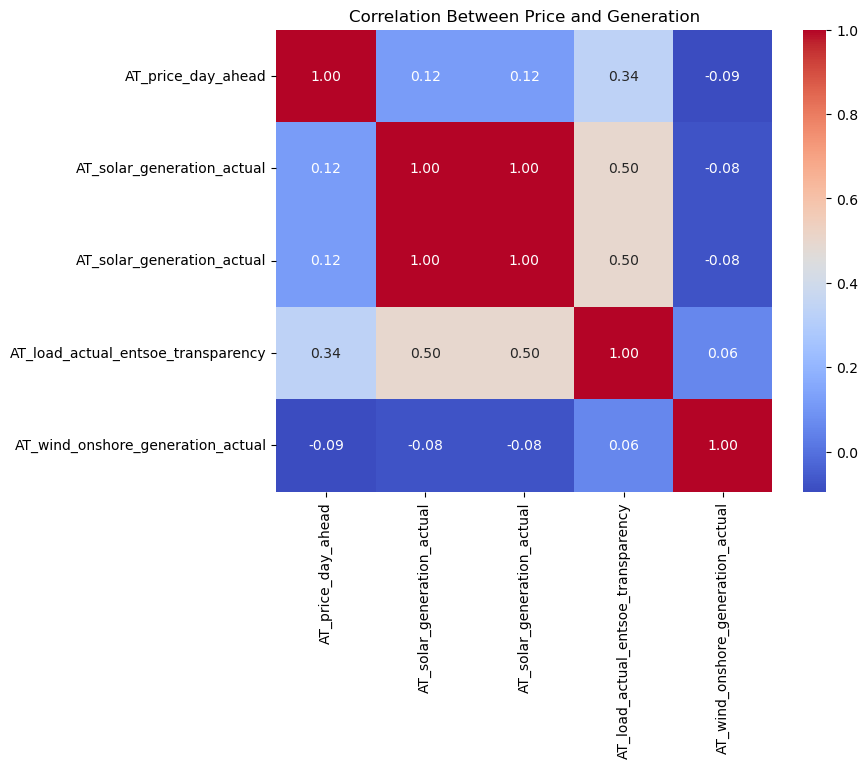

In [138]:
correlation_data = df[['AT_price_day_ahead','AT_solar_generation_actual', 'AT_solar_generation_actual','AT_load_actual_entsoe_transparency', 'AT_wind_onshore_generation_actual']].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_data, annot=True, fmt='.2f', cmap='coolwarm')
plt.title('Correlation Between Price and Generation')
plt.show()


1. **Price is strongly correlated with load.**
2. **Solar generation has a positive impact on price and load.**
3. **Wind generation has a slight negative impact on price and a slight positive impact on load.**
4. **Load is strongly correlated with solar generation.**


### Cumulative Load vs. Day-Ahead Price in Austria by Scatter Plot

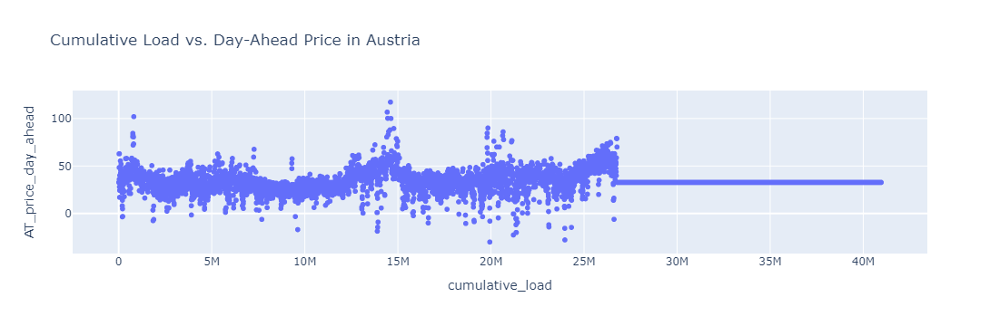

In [141]:
df['cumulative_load'] = df['AT_load_actual_entsoe_transparency'].cumsum()
fig = px.scatter(df, x='cumulative_load', y='AT_price_day_ahead',
                 title='Cumulative Load vs. Day-Ahead Price in Austria', labels={'x': 'Cumulative Load (MW)', 'y': 'Day-Ahead Price (€)'})
fig.show()


1. **There is a weak negative correlation between cumulative load and day-ahead price in Austria.**
2. The relationship is not perfectly linear, and other factors may influence day-ahead price.


### Correlation between price and load

In [144]:
price_correlation = df[['AT_price_day_ahead', 'AT_load_actual_entsoe_transparency']].corr()
print(price_correlation)


                                    AT_price_day_ahead  \
AT_price_day_ahead                            1.000000   
AT_load_actual_entsoe_transparency            0.336791   

                                    AT_load_actual_entsoe_transparency  
AT_price_day_ahead                                            0.336791  
AT_load_actual_entsoe_transparency                            1.000000  


* **Correlation coefficient:** The correlation coefficient between "AT_price_day_ahead" and "AT_load_actual_entsoe_transparency" is 0.336791.
* This indicates a moderate positive correlation between the two variables.
* **Positive correlation:** The positive sign of the correlation coefficient suggests that as "AT_price_day_ahead" increases, "AT_load_actual_entsoe_transparency" tends to increase as well.


### Histogram showing Load Distribution During High Price Periods

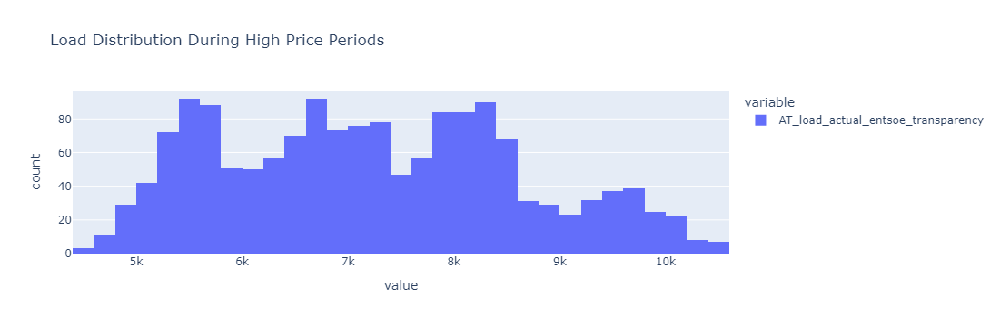

In [147]:
high_price_threshold = df['AT_price_day_ahead'].quantile(0.75)
high_price_load_reduction = df[df['AT_price_day_ahead'] > high_price_threshold]['AT_load_actual_entsoe_transparency']

fig = px.histogram(high_price_load_reduction, title='Load Distribution During High Price Periods')
fig.show()


The histogram shows the distribution of load during high price periods. Here are the key points:

* The distribution is skewed to the right, indicating that there are a few high outliers.
* The majority of the load values fall between 6k and 9k.
* The distribution is relatively symmetrical around the median, which suggests that the majority of the load values are clustered around the middle.
